<div class="usecase-title">Improving walkability in the City of Melbourne</div>

<div class="usecase-authors"><b>Authored by: </b> Hannah Smith</div>

<div class="usecase-duration"><b>Duration:</b> 120 mins</div>

<div class="usecase-level-skill">
    <div class="usecase-level"><b>Level: </b>Beginner</div>
    <div class="usecase-skill"><b>Pre-requisite Skills: </b>Python</div>
</div>

<div class="usecase-section-header">Scenario</div>

- As a resident or potential resident of the City of Melbourne, I want to identify how walkable a neighbourhood by viewing amenity density, access to public transport, or ease of walking.
- As a resident or visitor I want to identify which streets are pleasant to walk along based on typical traffic conditions or steepness.
- As a city planner, I want to identify which areas have potential to be more walkable based on residential density and ease of walking.

<div class="usecase-section-header">What this use case will teach you</div>

At the end of this use case you will be able to:
- combine datasets to produce new information
- visualise data by grid
- visualise shape data on a map
- add useful information to maps to make extracting insights easier

<div class="usecase-section-header">Why is walkability important?</div>

Walkability is a planning concept where people can access amenities in their neighbourhoods easily on foot <a href="#fn-1">[1]</a>. It is based on the idea that urban spaces should be liveable spaces for all types of users and transportation modes, and not merely designed for maximum vehicle throughput. It aims to reduce the need for cars to travel and provide citizens with healthy, safe, sustainable environments <a href="#fn-2">[2]</a>.

This use case is intended to provide advocates and council workers in the City of Melbourne with information that will create better policies regarding walkability.

### What are the metrics for walkability?

Walkability is typically measured by identifying three things about an area <a href="#fn-3">[3]</a>:

- Is there something to walk to (to run errands, use parks or public transport)?

- Is it easy to find direct routes when getting around?

- How dense is the housing?

These factors will increase the probability of people choosing to walk for transportation.

#### Something to walk to

This can be measured by the percentage of people with access to certain amenities, or by sampling an area and estimating distances to different features. Since calculating access to all different types of amenity would be difficult, a proxy for this is typically done using certain types of amenities. This can include regular public transportation (as measured by either 20 or 30 minute services), places to buy healthy food (groceries or supermarkets), and public open space larger than 1.5 hectares.

#### A way to get there

Walkability is concerned with street connectivity, as measured by the density of intersections. This is because grid-style layouts tend to provide easier access to amenities as people can walk there directly <a href="#fn-4">[4]</a>.

#### Dense housing

Higher population density, as measured by the population density per square kilometre, is associated with an increased need for different types of services and land uses <a href="#fn-5">[5]</a> <a href="#fn-6">[6]</a>.

Sampling in one study <a href="#fn-7">[7]</a> was done by sampling points every 30 metres along the pedestrian street network to estimate population and street intersection densities, as well as distance to several features. This study will use a grid technique to make a quick estimation for an area, which can be flexibly made smaller or larger depending on the amount of precision required.

Walkability is an important part of health, as recent research indicates neighbourhoods exceeding certain benchmarks are associated with better physical health <a href="#fn-8">[8]</a>.

<div class="usecase-section-header"> What does this use case aim to do? </div>

Although Greater Melbourne falls short of walkability metrics, the City of Melbourne has a much higher walkability<a href="#fn-9">[9]</a>. This use case seeks visualise the detailes about walkability in the City, and explore some extra metrics that could be used to improve walkability and thus citizen health.

Some key problems identified in a 2018 report produced for the City <a href="#fn-10">[10]</a> will be addressed, with more to be mentioned in the suggestions for further research at the end of this document. On the importance of pedestrian movement in the city, this use case will include measures of delay when walking as the 2018 report notes that given the majority of internal trips in the City are on foot more consideration to pedestrian delay is warranted.

<div class="usecase-section-header">Relevant datasets</div>

<div class="usecase-subsection-blurb">From the City of Melbourne Open Data</div>

Residential dwellings (2021)

- used to determine residential density
- https://data.melbourne.vic.gov.au/explore/dataset/residential-dwellings/information/

Pedestrian network

- pedestrian walking routes
- used to identify the ease of movement through areas
- https://data.melbourne.vic.gov.au/explore/dataset/pedestrian-network/information/

Footpath steepness
- Gradients of all City of Melbourne public footpaths
- https://data.melbourne.vic.gov.au/explore/dataset/footpath-steepness/information/

Road network
- Used to analyse road conditions
- https://data.melbourne.vic.gov.au/explore/dataset/road-corridors/information/

<div class="usecase-subsection-blurb">External</div>

ABS Statistics about the population for Australia's capital cities and regions
- need to download 'Population estimates by SA2 (ASGS2021), 2001 to 2021, in GeoPackage' onto your local machine
- https://www.abs.gov.au/statistics/people/population/regional-population/latest-release#data-download 

Speed Zone Data
- Used to analyse road conditions
- https://discover.data.vic.gov.au/dataset/speed-zone-data

OpenStreetMap data
- To access this data the hotosm website can be used to perform a keyword search on amenities
- See the appendix in reference <a href="#fn-7">[7]</a> for the key words used to search the OpenStreetMap database - this use case only looked at healthy food, convenience, and public transport. It did not consider open space, or transport frequence.

### Imports

In [621]:
# Importing from the API
import requests
import os
import fiona
from io import BytesIO
from zipfile import ZipFile
# Working with the data
import numpy as np
import pandas as pd
import geopandas as gpd
import json
from sklearn.preprocessing import MinMaxScaler
# Working with shape files and geo data
import shapely
from shapely.geometry import Polygon, MultiPolygon, Point
# Visualisation
import matplotlib.pylab as plt
import folium
from folium import plugins
import seaborn as sns
import branca.colormap as cm

%matplotlib inline

##### The City of Melbourne LGA file

This is used to trim geographical data sets to the correct area, see the green roof use case for details on this data source.

In [622]:
LGA_shape = gpd.read_file("./interactive_dependencies/greenroof_usecase/urban_heat/Local Government Area Solid.shp")

# Select only the relevant columns, and convert to the coordinate system that will be used for this use case
LGA_shape_gdf = LGA_shape.filter(['LGA_NAME', 'geometry']).to_crs('epsg:4326')

<div class="usecase-section-header">Visualising walkability</div>

### Residential density

Will use the residential dwellings as a proxy, but combined with ABS population data from latest census.

##### Dwelling density

In [623]:
dwelling_url =  "https://data.melbourne.vic.gov.au/explore/dataset/residential-dwellings/download/?format=geojson&refine.census_year=2021&timezone=Australia/Sydney&lang=en"
dwelling_response = requests.get(url=dwelling_url)

In [624]:
def to_geopandas(response:requests.models.Response):
    """
    Builds a GeoDataFrame of the reponse content features.
            Parameters:
                    response (requests.models.Response): HTTP Response object from the API
            Returns:
                    gdf (GeoDataFrame): A GeoDataFrame
    """
    b = bytes(response.content)
    with fiona.BytesCollection(b) as f:
        crs = f.crs['init']
        gdf = gpd.GeoDataFrame.from_features(f, crs=crs)
    return gdf

In [660]:
residential_gdf = to_geopandas(dwelling_response)
residential_gdf.head()

,geometry,longitude,property_id,building_address,clue_small_area,block_id,base_property_id,census_year,dwelling_number,latitude,dwelling_type
0,POINT (144.95651 -37.82098),144.95651,611394,545-557 Flinders Street MELBOURNE VIC 3000,Melbourne (CBD),1,611394,2021,196,-37.82098,Residential Apartments
1,POINT (144.95649 -37.81988),144.95649,103957,517-537 Flinders Lane MELBOURNE VIC 3000,Melbourne (CBD),11,103957,2021,26,-37.81988,Residential Apartments
2,POINT (144.95577 -37.82061),144.95577,103986,556-560 Flinders Street MELBOURNE VIC 3000,Melbourne (CBD),11,103986,2021,3,-37.82061,Residential Apartments
3,POINT (144.95615 -37.82050),144.95615,103988,546-548 Flinders Street MELBOURNE VIC 3000,Melbourne (CBD),11,103988,2021,111,-37.82050,Residential Apartments
4,POINT (144.95827 -37.81973),144.95827,103997,472-482 Flinders Street MELBOURNE VIC 3000,Melbourne (CBD),12,103997,2021,3,-37.81973,Residential Apartments


##### ABS population statistics

This is more accurate than the dwelling count, since the dwellings do not actually get inspected and thus could be unoccupied. There is also no information about how many people live in each dwelling. However, the ABS data is at Statistical Area 2, which roughly corresponds to the size of a suburb.

In [627]:
population_raw = gpd.read_file("./interactive_dependencies/walkability/SA2 ERP GeoPackage 2021 (ASGS2021).gpkg")
# only need the latest population information form the 2021 census
population_gdf = population_raw.filter(["SA4_code_2021", "SA3_code_2021", "SA2_name_2021", "ERP_2021", "Area_km2", "Pop_density_2021_people_per_km2", "geometry"])
# trim by area code
population_gdf = population_gdf[population_gdf['SA4_code_2021'] == 206]

Viewing the data we can see some are coming from outside the LGA, as seen in Statistica Areas 2 and 3 names (e.g. 'Brunswick').

If we filtered more finely using the SA3 code 20604 'Melbourne city', that will clip out some sections from the LGA. We need to visually confirm using the map what should be kept.

In [628]:
population_gdf.head()

,SA4_code_2021,SA3_code_2021,SA2_name_2021,ERP_2021,Area_km2,Pop_density_2021_people_per_km2,geometry
753,206,20601,Brunswick East,12963,2.1682,5978.691895,"POLYGON ((144.97307 -37.76388, 144.97340 -37.7..."
754,206,20601,Brunswick West,14499,3.1795,4560.150879,"POLYGON ((144.93407 -37.75969, 144.93405 -37.7..."
755,206,20601,Pascoe Vale South,10461,2.9887,3500.184082,"POLYGON ((144.93264 -37.74226, 144.93251 -37.7..."
756,206,20601,Brunswick - North,13091,2.4091,5433.979492,"POLYGON ((144.95031 -37.75810, 144.95044 -37.7..."
757,206,20601,Brunswick - South,13215,2.7334,4834.638184,"POLYGON ((144.94985 -37.77016, 144.94929 -37.7..."


We can overlay the population data with the LGA boundary on a map, and manually compare with the dwelling density records.

Let's create a map to visualise and confirm the data

In [629]:
# Creating a map
pop_map = folium.Map(location=[-37.8155, 144.95], tiles='cartodbpositron', min_zoom=11, zoom_start=13)

In [630]:
# Mapping function

def map_df(dataFrame, dfMap:folium.Map, columns:list=None, labels:list=None, description:str='Untitled',
        styleFunction=None, highlightFunction=None, colorMap=None, overlay=True, show=True):
    """
    Builds a layer for a data frame and adds it to a Folium map.

        Parameters:
            dataFrame (DataFrame or GeoDataFrame, required): The dataframe to be mapped.
            dfMap (folium.Map, required): The Folium map to add the feature to.
            columns (list): List of the columns to be included in the map, with the most important column at index 0, 'geometry' must be last.
            labels(list): Labels/aliases to use in place of provided column names for the tooltip (don't include one for 'geometry').
            description (str): A short description visible in map layers,
            styleFunction (dict): The styling for the fill and outline colours.
            highlightFunction (dict): The styling for the highlight.
            overlay (bool): Sets as an overlay (Radio Button).
            show (bool): Sets if layer shows by default when map is displayed
    """
    # Add to its own feature group so it can be turned on and off.
    featureGroup = folium.FeatureGroup(name=description, overlay=overlay, show=show).add_to(dfMap)
    
    # Default style and highlight functions if none are provided:
    if styleFunction is None:
        styleFunction = {
            'color': 'black',
            'fillOpacity': 0.2,
            'opacity': .3,
            'weight': 1
        }
    if highlightFunction is None:
        highlightFunction = {
            'fillOpacity': 0.7,
            'opacity': .5,
            'color': "blue"
        }
    
    # If the columns are specified:
    if columns is not None:
        # Transform geo data into geoJson.
        geoJSON = dataFrame[columns].copy().to_json()

        # Add Layer Control name by adding the dataset name to json properties.
        geoJSON = json.loads(geoJSON)
        for entry in geoJSON['features']:
            entry['properties']['dataset'] = description

        # Add 'dataset' to the columns & labels lists for tooltip use.
        columns.insert(0, 'dataset')
        labels.insert(0, 'dataset')
        # Uses the colour map if one is specified
        if colorMap is None:
            feature = folium.GeoJson(
                geoJSON,
                style_function=lambda feature: styleFunction,
                # Controls behaviour when the user hovers the mouse over the feature
                highlight_function=lambda feature: highlightFunction,
                # Hover tool tip will include all information except the 'geometry' column
                tooltip=folium.GeoJsonTooltip(
                    fields=columns[:-1],
                    aliases=labels)
            ).add_to(featureGroup) # Add the features to the group
        else:
            feature = folium.GeoJson(
                geoJSON,
                style_function=lambda feature: {
                    'fillColor': colorMap(feature['properties'][columns[1]]),
                    'fillOpacity': styleFunction['fillOpacity'],
                    'opacity': styleFunction['opacity'],
                    'weight': styleFunction['weight']
                },
                highlight_function=lambda feature: highlightFunction,
                tooltip=folium.GeoJsonTooltip(
                    fields=columns[:-1],
                    aliases=labels)
            ).add_to(featureGroup)

    if columns is None:
        folium.GeoJson(
        dataFrame,
        name=description,
        style_function=lambda feature: styleFunction,
        ).add_to(featureGroup)

First, we should add the City of Melbourne LGA border to the map so it is the bottom layer.

In [631]:
map_df(LGA_shape_gdf,pop_map,description="CoM LGA border", styleFunction={
    'fillOpacity': 0,
    'color': 'black',
    'opacity': 1,
    'weight': 3
})

Next, add the population for each area from the ABS statistics.

In [632]:
map_df(population_gdf,
       pop_map,
       ['ERP_2021','Pop_density_2021_people_per_km2', 'SA2_name_2021','Area_km2','geometry'],
       ['Population', 'Pop density', 'area name' , 'Area in km2'],
       "Population per SA2",
       {'fillOpacity': 0.5,
        'opacity': 0, #ensure there is space to see the LGA border
        'weight': 3},
       # use the min and max value of the variable being color mapped
       colorMap=cm.linear.YlGnBu_07.scale(population_gdf['ERP_2021'].min(), population_gdf['ERP_2021'].max()))

Finally, add markers indicating the dwelling locations. To do this we will create a list by iterating over each row and storing the coordinates, as well as the dwelling numbers. ```FastMarkerCluster``` is a much higher performing way to add markers to the map compared with using the shapely geometry in the dataframe.

In [633]:
# Create locations for each dwelling, as indicated by their location and the dwelling numbers per site
locations = []

for row in residential_gdf.iloc:
    location = [(row.latitude, row.longitude)]*row['dwelling_number']
    locations += location

dwelling_fg = folium.FeatureGroup(name="Dwelling count", overlay=True, show=True).add_to(pop_map)

marker_cluster = plugins.FastMarkerCluster(
    data=locations,
    # Customise the binning of marker size
    icon_create_function = '''
    function (cluster) {
        var childCount = cluster.getChildCount();
        var c = ' marker-cluster-';
        if (childCount < 100) {
            c += 'small';
        }
        else if (childCount < 2000) {
            c += 'medium';
            }
        else {
            c += 'large';
        }
        return new L.DivIcon({
            html: '<div><span>' + childCount + '</span></div>',
            className: 'marker-cluster' + c,
            iconSize: new L.Point(40, 40)
        });
    }'''
    ).add_to(dwelling_fg)

Looking at the map below, we can confirm that in the population density data the darker areas (more populated) also correspond with more dwellings.

In [634]:
folium.LayerControl().add_to(pop_map) # Add the layer control to switch layers
pop_map

The Port Melbourne industrial area we lose by clipping to the LGA has no dwellings, and so we won't lose any data accuracy by clipping, no changes needed.

We can also safely exclude Carlton North from our counts, as there is only one dwelling recorded in that area located in Princes Park and no dwellings in the cemetary.

In [661]:
# drop all not in Melbourne City expect the Port Melb Industrial
population_LGA = gpd.overlay(population_gdf.to_crs(4326), LGA_shape_gdf, how='intersection')
population_trim = population_LGA[(population_LGA.SA3_code_2021 == 20604) | 
                                 (population_LGA.SA2_name_2021 == 'Port Melbourne Industrial') |
                                (population_LGA.SA2_name_2021 == 'Carlton North - Princes Hill')]

Next set Port Melb Industrial area to 0 since there are almost no dwellings there, possibly unoccupied. The population counts are likely coming from outside the City of Melbourne. The Carlton area will also be zeroed.

In [662]:
idx = population_trim.index[population_trim['SA2_name_2021'] == 'Port Melbourne Industrial'][0]
population_trim.at[idx,'ERP_2021'] = 0
population_trim.at[idx,'Pop_density_2021_people_per_km2'] = 0

idx = population_trim.index[population_trim['SA2_name_2021'] == 'Carlton North - Princes Hill'][0]
population_trim.at[idx,'ERP_2021'] = 0
population_trim.at[idx,'Pop_density_2021_people_per_km2'] = 0

Let's visualise all the trimmed population information

In [664]:
pop_map2 = folium.Map(location=[-37.8155, 144.95], tiles='cartodbpositron', min_zoom=11, zoom_start=13)

map_df(LGA_shape_gdf,pop_map2,description="CoM LGA border", styleFunction={
    'fillOpacity': 0,
    'color': 'black',
    'opacity': 1,
    'weight': 3
})

map_df(population_trim.round(4), # Rounding to make numbers easier to read
       pop_map2,
       ['Pop_density_2021_people_per_km2','ERP_2021','SA2_name_2021','Area_km2','geometry'],
       ['Pop density', 'Population', 'area name' , 'Area in km2'],
       "Population Density",
       {'fillOpacity': 0.5,
        'opacity': 0, #ensure there is space to see the LGA border
        'weight': 3},
       # use the min and max value of the variable being color mapped
       colorMap=cm.linear.YlGnBu_07.scale(population_trim['Pop_density_2021_people_per_km2'].min(), population_trim['Pop_density_2021_people_per_km2'].max()))


folium.LayerControl().add_to(pop_map2)
pop_map2

We can see that the population density is highest in Melbourne CBD North and South Bank, to be expected as those areas have a lot of high rise buildings.

To make this data more visible in small areas, we will need to create a grid to summarise both the population density and dwelling density into.

##### Summarising the residential datasets

In [639]:
# create a grid for geometry
def create_grid(n_boxes = 16):
    """
    Generates a grid using the LGA geopandas DataFrame
        Parameters:
        n_boxes (int): defaults to 16, number of boxes for the x/y length of the grid
        Returns:
        gdf_grid (GeoDataFrame): the grid as a geopandas dataframe
    """
    
    LGA = LGA_shape_gdf.loc[:, ["geometry"]]
    
    a, b, c, d = LGA.total_bounds
    
    gdf_grid = gpd.GeoDataFrame(
        geometry=[
            shapely.geometry.box(minx, miny, maxx, maxy)
            for minx, maxx in zip(np.linspace(a, c, n_boxes), np.linspace(a, c, n_boxes)[1:])
            for miny, maxy in zip(np.linspace(b, d, n_boxes), np.linspace(b, d, n_boxes)[1:])
        ],
        crs="epsg:4326",
    )
    
    # remove grid boxes created outside actual geometry
    gdf_grid = gdf_grid.sjoin(LGA).drop(columns="index_right")
    
    return gdf_grid

While creating visuals for the the individual metrics, we will also create a summary grid to be used at the end for the final walkability score. This will be much more detailed, with areas of approximately 200 x 200m2.

In [714]:
# create grids
summary_grid = create_grid(50)
pop_density_grid = create_grid()

In [715]:
# add the residential data to the grid
dwellings = residential_gdf.loc[:, ["geometry", "dwelling_number"]].sjoin(pop_density_grid)

pops = population_trim.loc[:, ["geometry", 'Pop_density_2021_people_per_km2']].sjoin(pop_density_grid)

dwellings2 = residential_gdf.loc[:, ["geometry", "dwelling_number"]].sjoin(summary_grid)
pops2 = population_trim.loc[:, ["geometry", 'Pop_density_2021_people_per_km2']].sjoin(summary_grid)

Next we use ```.dissolve()```, a geopandas method that can be used to aggregate information for a given area.

In [716]:
# Aggregating by mean
pop_density_grid = pop_density_grid.join(
    pops.dissolve(by="index_right", aggfunc="mean").drop(columns="geometry")
)

# Since this is a count metric, this will be summed
pop_density_grid = pop_density_grid.join(
    dwellings.dissolve(by="index_right", aggfunc="sum").drop(columns="geometry")
)

# Summary
summary_grid = summary_grid.join(
    pops2.dissolve(by="index_right", aggfunc="mean").drop(columns="geometry")
)

summary_grid = summary_grid.join(
    dwellings2.dissolve(by="index_right", aggfunc="mean").drop(columns="geometry")
)

In [717]:
# Removing null rows
pop_density_grid_filt = pop_density_grid.dropna()

pop_density_grid_filt.head()

,geometry,Pop_density_2021_people_per_km2,dwelling_number
19,"POLYGON ((144.90956 -37.83061, 144.90956 -37.8...",0.000000,1.0
42,"POLYGON ((144.91585 -37.79049, 144.91585 -37.7...",45.632702,3.0
55,"POLYGON ((144.92214 -37.80052, 144.92214 -37.7...",2532.370850,449.0
56,"POLYGON ((144.92214 -37.79551, 144.92214 -37.7...",2555.187201,878.0
57,"POLYGON ((144.92214 -37.79049, 144.92214 -37.7...",2555.187201,91.0


Next, we add a column with the relevant data normalised. This will make it easier to create a combined metric.

In [ ]:
dwell_scaler = MinMaxScaler()
pop_scaler = MinMaxScaler()

# Scaling the normalised column into a range of [0,1]
pop_density_grid_filt[['dwelling_no_norm']] = dwell_scaler.fit_transform(pop_density_grid_filt[['dwelling_number']])

pop_density_grid_filt[['pop_density_norm']] = pop_scaler.fit_transform(pop_density_grid_filt[['Pop_density_2021_people_per_km2']])

Lastly, we need to combine the two metrics to create a single point of data to visualise residential density in the City of Melbourne, and do the same thing again with the ```summary_grid```.

In [ ]:
pop_density_grid_filt['pop_density'] = (pop_density_grid_filt['pop_density_norm'] + pop_density_grid_filt['dwelling_no_norm'])/2

In [720]:
summary_grid[['dwelling_no_norm']] = dwell_scaler.fit_transform(summary_grid[['dwelling_number']])

summary_grid[['pop_density_norm']] = pop_scaler.fit_transform(summary_grid[['Pop_density_2021_people_per_km2']])

summary_grid['pop_density'] = (summary_grid['pop_density_norm'] + summary_grid['dwelling_no_norm'])/2

In [684]:
# Rounding
pop_density_grid_filt = pop_density_grid_filt.round(4)

# Create colourmap matching scale of data
res_cmap = cm.linear.YlGnBu_07.scale(pop_density_grid_filt['pop_density'].min(), pop_density_grid_filt['pop_density'].max())

# Visualising
pop_density_grid_filt.explore('pop_density', cmap=res_cmap, location=[-37.8155, 144.95], tiles="cartodbpositron", zoom_start=13)

### Getting around

#### Routes or paths for pedestrians to take

Intersection density is often used as a proxy for direct paths - more intersections typically means it is more likely there will be a direct route to a pedestrian's destination, making walking more appealing. 

Although there is a road dataset available on the open data portal, it does not label all intersections, only the major road intersections. It also does not account for light timings.

Instead we can use the cost column in the pedestrian network dataset.

In [87]:
# Get the pedestrian network data
ped_url = 'https://data.melbourne.vic.gov.au/api/datasets/1.0/pedestrian-network/alternative_exports/pedestrian_network_zip/'
ped_response = requests.get(url=ped_url)

In [88]:
# Check the names of the files to get the one we want
f = ZipFile(BytesIO(ped_response.content))
print(f.namelist())

['Property_centroid.json', 'Pedestrian_network.json']


In [141]:
ped = f.extract('Pedestrian_network.json')

with open('Pedestrian_network.json') as file:
    pedestrian_gdf = gpd.read_file(file)

We can examine the metadata document to learn which columns are relevant.

The ```Otime``` and ```Ctime``` are opening and closing time, which are not actually accurate to some of the private pathways that go through places like shopping arcades. For this use case, we will ignore time of day. 

```COST``` refers to a suggested cost for modelling situations based on the type of object. This is useful as it includes some data about crossing time, although it is merely a classification into either short (15 secs) or long (30 secs) rather than a precise measurement.

The ```centroid connector``` is used for path modelling, applying a significant cost (500 minutes) to avoid modelling software trying to cut through buildings when pedestrians would typically use the footpath. We can safely filter those out for this use case. Similarly ```entrance conextor``` is a type of entrance to a building and unnecessary.

In [142]:
# Finding and fixing spelling errors
column_list = pedestrian_gdf['DESCRIPTION'].unique(); column_list

array(['Pestrian Footpath', 'Pedestrian Long wait Croosing',
       'Short wait crosing', 'zebra', 'Tram crossing', 'Arcade', 'Lane',
       'Entrance conextor', 'Centroid Connector'], dtype=object)

In [143]:
# Filter unnecessary columns
pedestrian_gdf  = pedestrian_gdf.filter(['COST', 'Shape_Length', 'DESCRIPTION', 'TRAFFIC','geometry'])

# Create a dictionary of spelling mistakes to fix
spelling_fix = {
    'Pestrian Footpath': 'Pedestrian Footpath',
    'Pedestrian Long wait Croosing':  'Pedestrian Long Wait Crossing',
    'Short wait crosing': 'Short Wait Crossing',
    'zebra': 'Zebra',
    'Tram crossing': 'Tram Crossing'}

pedestrian_gdf = pedestrian_gdf.replace(spelling_fix)

In [144]:
# Filtering
pedestrian_gdf = pedestrian_gdf[(pedestrian_gdf.DESCRIPTION != 'Centroid Connector') & (pedestrian_gdf.DESCRIPTION != 'Entrance conextor')]

# Viewing cleaned dataset
pedestrian_gdf.head()

,COST,Shape_Length,DESCRIPTION,TRAFFIC,geometry
0,1.856134,123.742235,Pedestrian Footpath,High Traffic,"LINESTRING (144.98254 -37.84522, 144.98392 -37..."
1,0.031922,2.128135,Pedestrian Footpath,High Traffic,"LINESTRING (144.98042 -37.84496, 144.98041 -37..."
2,3.098050,206.536685,Pedestrian Footpath,Low Traffic,"LINESTRING (144.98041 -37.84494, 144.97973 -37..."
3,1.408645,93.909699,Pedestrian Footpath,Low Traffic,"LINESTRING (144.98475 -37.84455, 144.98493 -37..."
4,0.515907,34.393783,Pedestrian Footpath,Low Traffic,"LINESTRING (144.98531 -37.84377, 144.98493 -37..."


##### Visualising the pedestrian network

Below we can already see some potential barriers to walking - costs for waiting at an intersection can often exceed the walking cost for an entire block to that intersection.

In [94]:
ped_map = folium.Map(location=[-37.8155, 144.95], tiles="cartodbpositron", zoom_start=14)

map_df(pedestrian_gdf,
       ped_map,
       ['COST','DESCRIPTION', 'TRAFFIC','Shape_Length','geometry'],
       ['Cost', 'Description', 'Traffic' , 'Length'],
       "Pedestrian network",
       {'color': '#08af64', 'weight': 2, 'opacity':0.9})

ped_map

We can combine the number of paths with the total cost to create a metric measuring how easy it is to walk about the area.

A lot of paths and a relatively low cost indicates many well connected routes ideal for walking, whereas a low count of paths with a high cost.

##### Visualising the ease of walking as a cost metric


In [286]:
ped_grid = create_grid()
summary_grid2 = create_grid(50)

# Get all costs in the grid area
costs = pedestrian_gdf.loc[:, ["geometry", "COST"]].sjoin(ped_grid)
costs2 = pedestrian_gdf.loc[:, ["geometry", "COST"]].sjoin(summary_grid2)

For pedestrian network we want the total path count, the cost sum, and to then generate a column of relative cost.

In [287]:
# sum cost for grid cell
ped_grid = ped_grid.join(
    costs.dissolve(by="index_right", aggfunc="sum").drop(columns="geometry")
)

# count how many paths per grid cell
ped_grid = ped_grid.join(
    costs.dissolve(by="index_right", aggfunc=lambda d: len(d))
    .drop(columns="geometry")
    .rename(columns={"COST": "n_paths"})
)

In [288]:
# sum cost for grid cell
summary_grid2 = summary_grid2.join(
    costs2.dissolve(by="index_right", aggfunc="sum").drop(columns="geometry")
)

# count how many paths per grid cell
summary_grid2 = summary_grid2.join(
    costs2.dissolve(by="index_right", aggfunc=lambda d: len(d))
    .drop(columns="geometry")
    .rename(columns={"COST": "n_paths"})
)

In [289]:
#Generate relative cost for each line in the network
ped_grid['relative_cost'] = ped_grid['COST'] / ped_grid['n_paths']
summary_grid2['relative_cost'] = summary_grid2['COST'] / summary_grid2['n_paths']

# Remove empty rows and round
ped_grid = ped_grid.dropna().round(4)

In [611]:
summary_grid2.describe()

,COST,n_paths,relative_cost
count,1132.000000,1132.000000,1132.000000
mean,11.810248,29.787102,0.112617
std,6.281163,34.020118,0.160287
min,0.084618,1.000000,0.000000
25%,7.044287,4.000000,0.013636
50%,11.134481,14.000000,0.048914
75%,15.980278,48.000000,0.145192
max,33.086687,177.000000,1.000000


In [609]:
ped_scaler = MinMaxScaler()

# Scaling the normalised column into a range of [0,1]
ped_grid[['relative_cost']] = ped_scaler.fit_transform(ped_grid[['relative_cost']]).round(4)
summary_grid2[['relative_cost']] = ped_scaler.fit_transform(summary_grid2[['relative_cost']])

As this is a cost metric, lower numbers are more desirable. Therefore, we will need to create a custom colourmap that assigns darker colours to low numbers. This can be done using a step colour map, and the [ColorBrewer website](https://colorbrewer2.org "Color Advice") to select colours. The steps are decided using ```.describe()```.

In [618]:
# Custom colours
ped_cmap = cm.StepColormap(
    colors=['#0868ac','#43a2ca', '#7bccc4', '#bae4bc', '#f0f9e8'],
    vmin = 0,
    vmax = 1,
    index = [0, .013, .048, .145, 1], 
    caption = 'Path relative cost')

ped_grid.explore('relative_cost', cmap=ped_cmap, location=[-37.8155, 144.95], tiles="cartodbpositron", zoom_start=13)

This simple visualisation shows the areas that are easiest to walk through are found mainly around the Hoddle Grid. Areas with a higher relative cost include the industrial areas in the west of the City of Melbourne, as well as areas where large landmarks (such as the cemetary or sports stadiums) require pedestrians to make long detours to get around them. Varying costs within the Hoddle grid might be due in part to the traffic light timings.

### Local amenities and public transport

#### Amenities

Using techniques similar to <a href="#fn-7">[7]</a>, we can use data from OpenStreetMap to locate amenities in Melbourne.

Since it would be difficult to perform this for all types of amenities people sue for their daily errands, we need to filter the dataset into the most salient types of amenity. For example, healthy food stores like markets and supermarkets are important components for walkability since they are part of people's daily errands.

In [182]:
# open amenities data
openStreetMap = gpd.read_file("./interactive_dependencies/walkability/OSM_amenities/amenity.geojson")
openStreetMap.head()

,osm_id,opening_hours,shop,operator,tunnel,name,layer,railway,surface,name_en,amenity,bridge,highway,public_transport,building,version,tags,changeset,timestamp,geometry
0,6486790461,None,None,None,None,Noughts + Crosses,None,None,None,None,cafe,None,None,None,None,NaN,None,NaN,NaT,POINT (144.93997 -37.78080)
1,1029487964,None,None,None,None,Scopri,None,None,None,None,restaurant,None,None,None,None,NaN,None,NaN,NaT,POINT (144.97505 -37.79557)
2,623879153,Mo-Sa 11:00-18:00,convenience,None,None,Nicholson Street Mini Market,None,None,None,None,None,None,None,None,None,NaN,None,NaN,NaT,POINT (144.97494 -37.79628)
3,623878812,None,None,None,None,Casa Ferro,None,None,None,None,restaurant,None,None,None,None,NaN,None,NaN,NaT,POINT (144.97493 -37.79635)
4,2292065501,None,None,None,None,Alley Cat Pizza and Pasta,None,None,None,None,restaurant,None,None,None,None,NaN,None,NaN,NaT,POINT (144.98540 -37.80999)


This dataset has a lot of null values.

To filter, let's view the types of shops to make our selection, then making a dictionary of shop, amenity and building types to keep using the research guide but also adding any we think would match the categories. We are looking for both healthy food amenities and convenience.

In [164]:
shopList = openStreetMap['shop'].unique(); shopList

array([None, 'convenience', 'supermarket', 'kiosk', 'beverages', 'bakery',
       'vacant', 'mall', 'clothes', 'car_repair', 'pet', 'car', 'photo',
       'car_parts', 'kitchen', 'furniture', 'stationery', 'flooring',
       'bicycle', 'wholesale', 'hairdresser', 'wine', 'lottery',
       'hardware', 'tool_hire', 'confectionery', 'ticket', 'beauty',
       'yes', 'dry_cleaning', 'tyres', 'butcher', 'travel_agency',
       'household', 'jewelry', 'fabric', 'massage', 'alcohol',
       'interior_decoration', 'antiques', 'toys', 'musical_instrument',
       'sports', 'electronics', 'department_store', 'storage_rental',
       'computer', 'bathroom_furnishing', 'general', 'variety_store',
       'paint', 'doityourself', 'funeral_directors', 'rental',
       'cosmetics', 'books', 'trade', 'printing', 'newsagent', 'copyshop',
       'printer_ink', 'laundry', 'mobile_phone', 'houseware',
       'greengrocer', 'pawnbroker', 'shoes', 'tattoo', 'florist', 'music',
       'tiles', 'electrical', '

In [165]:
healthy_food = {'shop': ['supermarket', 'beverages', 'bakery', 'butcher', 'greengrocer', 'deli', 'seafood']}
convenience = {'shop': ['convenience', 'kiosk']}

Using the same technique on the amenity column:

In [167]:
healthy_food['amenity'] = ['marketplace', 'food_court']
convenience['amenity'] = ['convenience', 'fuel']

Next, filter the dataset to only contain the relevant rows using an ```or``` condition. For this metric, we don't want to trim precisely to the City of Melbourne, since residents of CoM will not remain within council boundaries when using amenities. A buffer has been applied using HotOSM's buffer option.

In [168]:
amenities_df = openStreetMap[openStreetMap.shop.isin(healthy_food['shop']) | 
                             openStreetMap.amenity.isin(healthy_food['amenity']) | 
                             openStreetMap.shop.isin(convenience['shop']) | 
                             openStreetMap.amenity.isin(convenience['amenity'])].filter(['osm_id','name','shop', 'amenity', 'building','geometry'])

Because we can use the OpenStreetMap tiles in Folium, can easily confirm this data by zooming in - we can see an icon representing the amenity if we use the ```.explore()``` method.

##### Visualising amenity density

In [290]:
amen_grid = create_grid()
summary_grid3 = create_grid(50)

amenities = amenities_df.loc[:, ["geometry", "name"]].sjoin(amen_grid)

amen_grid = amen_grid.join(
    amenities.dissolve(by="index_right", aggfunc="count").drop(columns="geometry")
    .rename(columns={"name": "n_amenities"})
)

amenities2 = amenities_df.loc[:, ["geometry", "name"]].sjoin(summary_grid3)

summary_grid3 = summary_grid3.join(
    amenities2.dissolve(by="index_right", aggfunc="count").drop(columns="geometry")
    .rename(columns={"name": "n_amenities"})
)

amen_grid = amen_grid.dropna().round(4)

In [292]:
amen_scaler = MinMaxScaler()

# Scaling the normalised column into a range of [0,1]
amen_grid[['amenities_norm']] = amen_scaler.fit_transform(amen_grid[['n_amenities']])

amen_grid['amenities_norm'] = amen_grid['amenities_norm'].round(4)

In [291]:
# Do the same for the summary
amen_scaler2 = MinMaxScaler()
summary_grid3[['amenities_norm']] = amen_scaler2.fit_transform(summary_grid3[['n_amenities']])

In [293]:
amen_cmap = cm.linear.YlGnBu_07.scale(amen_grid['amenities_norm'].min(), amen_grid['amenities_norm'].max())

amen_grid.explore('amenities_norm',cmap=amen_cmap,location=[-37.8155, 144.95], tiles="cartodbpositron", zoom_start=13)

We can see that as expected there are a denser amenities in the Hoddle Grid, where there are lot of retail stores, with non appearing in the industrial areas.

#### Density of public transport - nearby rail, tram, and bus stops
This will use the same techniques as above.

In [183]:
openStreetMap2 = gpd.read_file("./interactive_dependencies/walkability/OSM_transport/transport.geojson")
openStreetMap2.head()

,osm_id,operator,name,railway,amenity,public_transport,building,highway,version,tags,changeset,timestamp,geometry
0,2213992422,Yarra Trams,Stop 16: Peel Street,tram_stop,None,stop_position,None,None,NaN,None,NaN,NaT,POINT (144.98328 -37.80487)
1,4297530188,Yarra Trams,Stop 17: Charles Street,None,None,platform,None,None,NaN,None,NaN,NaT,POINT (144.98340 -37.80361)
2,4297530187,Yarra Trams,Stop 17: Charles Street,None,None,platform,None,None,NaN,None,NaN,NaT,POINT (144.98359 -37.80348)
3,2213858635,Yarra Trams,Stop 14: Napier Street,tram_stop,None,stop_position,None,None,NaN,None,NaN,NaT,POINT (144.97979 -37.80604)
4,4297530182,Yarra Trams,Stop 15: Gertrude Street,None,None,platform,None,None,NaN,None,NaN,NaT,POINT (144.98313 -37.80622)


Quite a few rows in this dataset have their data contained to the 'tags' column, which will need to be unpacked and have the data moved to the appropriate column.

In [184]:
for row in openStreetMap2.iloc:
    if row.tags != None: # If there is data in tags
        for key in row.tags.keys(): # Find the matching column
            if key in openStreetMap2.columns: 
                openStreetMap2.at[row.name, key] = row.tags[key] # Move the data there

Next, filter the data to remove stations not yet built by looking for 'construction' and remove station platforms, since these are creating duplicates as train station buildings are being mapped as well. Plus, for stations with many platforms this will skew the data.

Finally, we need to filter out irrelvant rows, especially the timestamp row which will cause errors for the visualisation.

In [185]:
transport_df = openStreetMap2[~openStreetMap2['tags'].astype(str).str.contains('construction', case=False)]
transport_df = transport_df[~transport_df['tags'].astype(str).str.contains('platform', case=False)]
transport_df = transport_df.filter(['osm_id', 'operator', 'name','railway','amenity','public_transport','building','highway','geometry'])
transport_df.head()

,osm_id,operator,name,railway,amenity,public_transport,building,highway,geometry
0,2213992422,Yarra Trams,Stop 16: Peel Street,tram_stop,None,stop_position,None,None,POINT (144.98328 -37.80487)
1,4297530188,Yarra Trams,Stop 17: Charles Street,None,None,platform,None,None,POINT (144.98340 -37.80361)
2,4297530187,Yarra Trams,Stop 17: Charles Street,None,None,platform,None,None,POINT (144.98359 -37.80348)
3,2213858635,Yarra Trams,Stop 14: Napier Street,tram_stop,None,stop_position,None,None,POINT (144.97979 -37.80604)
4,4297530182,Yarra Trams,Stop 15: Gertrude Street,None,None,platform,None,None,POINT (144.98313 -37.80622)


##### Visualising nearlby transport

In [294]:
trans_grid = create_grid()
summary_grid4 = create_grid(50)

transport = transport_df.loc[:, ["geometry", "name"]].sjoin(trans_grid)
transport2 = transport_df.loc[:, ["geometry", "name"]].sjoin(summary_grid4)

trans_grid = trans_grid.join(
    transport.dissolve(by="index_right", aggfunc="count").drop(columns="geometry")
    .rename(columns={"name": "n_transport"})
)
summary_grid4 = summary_grid4.join(
    transport2.dissolve(by="index_right", aggfunc="count").drop(columns="geometry")
    .rename(columns={"name": "n_transport"})
)

trans_grid = trans_grid.dropna().round(4)

In [295]:
trans_scaler = MinMaxScaler()

# Scaling the normalised column into a range of [0,1]
trans_grid[['trans_norm']] = trans_scaler.fit_transform(trans_grid[['n_transport']]).round(4)

# Summary
trans_scaler2 = MinMaxScaler()

# Scaling the normalised column into a range of [0,1]
summary_grid4[['trans_norm']] = trans_scaler2.fit_transform(summary_grid4[['n_transport']]).round(4)

In [297]:
trans_cmap = cm.linear.YlGnBu_07.scale(trans_grid['trans_norm'].min(), trans_grid['trans_norm'].max())

trans_grid.explore('trans_norm',cmap=trans_cmap,location=[-37.8155, 144.95], tiles="cartodbpositron", zoom_start=13)

We can see this map has the highest density of available public transport around major train stations that also have nearby tram or bus routes. There is also a high density along St Kilda Rd and north of the CBD, where there are many tram routes.

### Walkability score

Finally, we can combine these different metrics into a single score and visualise all of them on a single map.

In [726]:
final = summary_grid.filter(['geometry','pop_density']).copy()

final['relative_cost'] = summary_grid2['relative_cost']
final['amenities_norm'] = summary_grid3['amenities_norm']
final['trans_norm'] = summary_grid4['trans_norm']

# Tranforming null values to 0
final = final.fillna(0)

In [733]:
# Creating a single score
final['walkability'] = (final['relative_cost'] + final['pop_density'] + (final['amenities_norm'] + final['trans_norm'])/2)

final= final.round(4)

In [734]:
final.describe()

,pop_density,relative_cost,amenities_norm,trans_norm,walkability
count,1444.000000,1444.000000,1444.000000,1444.000000,1444.000000
mean,0.054731,0.088283,0.029778,0.022853,0.169329
std,0.113950,0.149285,0.106020,0.056093,0.189509
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.004075,0.000000,0.000000,0.033775
50%,0.000000,0.025000,0.000000,0.000000,0.113350
75%,0.071725,0.108050,0.000000,0.000000,0.230025
max,0.824400,1.000000,1.000000,1.000000,1.154300


In [735]:
walk_cmap = cm.StepColormap(
    colors=['#ffffcc', '#a1dab4','#41b6c4', '#2c7fb8', '#253494'],
    vmin = 0,
    vmax = 1.154300,
    index = [0, 0.033775, 0.113350, 0.230025, 1.154300], 
    caption = 'Walkability')

In [736]:
# Trim to the boundary
final_trim = gpd.overlay(final, LGA_shape_gdf, how='intersection')

In [741]:
# Creating a map
walk_map = folium.Map(location=[-37.8155, 144.95], tiles='cartodbpositron', min_zoom=11, zoom_start=13)

# Adding the City of Melbourne boundary
map_df(
    LGA_shape_gdf,
    walk_map,
    description="CoM LGA border",
    styleFunction = {'fillOpacity': 0,'color': 'black','opacity': 1,'weight': 3},
    show=False
)

map_df(
    final_trim,
    walk_map,
    ['walkability', 'relative_cost','amenities_norm', 'trans_norm', 'pop_density', 'geometry'],
    ['WALKABILITY', 'Ease of movement (cost)', 'Number of amenities', 'Transport' , 'Population Density'],
    "Walkability score per ~200m2 grid box",
    styleFunction = {'opacity':.7, 'fillOpacity':0.6, 'weight': 0.3,},
    highlightFunction = {'opacity':.9, 'fillOpacity':0.9, 'weight': 0.3,},
    colorMap=walk_cmap
)

folium.LayerControl().add_to(walk_map)

In [742]:
walk_map

<div class="usecase-section-header">Extending walkability</div>

Let's add steepness to our visualisations using the footpath steepness. The steepness of a footpath can affect accessibility.

In [401]:
# Getting the data
steepness_url =  "https://data.melbourne.vic.gov.au/explore/dataset/footpath-steepness/download/?format=geojson&timezone=Australia/Sydney&lang=en"
steepness_response = requests.get(url=steepness_url)

In [498]:
footpath_steepness_gdf = to_geopandas(steepness_response)
footpath_steepness_gdf.head()

,geometry,deltaz,mccid_int,distance,gradepc,asset_type,grade1in,rlmax,rlmin,mcc_id,streetid,statusid,address,segside
0,"MULTIPOLYGON (((144.91014 -37.80104, 144.91014...",7.08,NaN,45.85,15.44,Road Footway,6.5,8.43,1.35,1390653,NaN,None,None,None
1,"MULTIPOLYGON (((144.90809 -37.80639, 144.90809...",4.67,22771.0,18.29,25.53,Road Footway,3.9,7.65,2.98,1390150,117858.0,1,Shepherd Bridge from Footscray Road,None
2,"MULTIPOLYGON (((144.91026 -37.80085, 144.91026...",7.19,22770.0,48.08,14.96,Road Footway,6.7,8.39,1.20,1390654,117856.0,1,Hopetoun Bridge from Dynon Road,None
3,"MULTIPOLYGON (((144.90824 -37.80643, 144.90825...",0.00,22771.0,0.00,0.00,Road Footway,NaN,2.46,2.46,1389305,117858.0,1,Shepherd Bridge from Footscray Road,None
4,"MULTIPOLYGON (((144.90825 -37.80644, 144.90825...",0.99,22771.0,2.80,35.34,Road Footway,2.8,4.79,3.80,1386038,117858.0,1,Shepherd Bridge from Footscray Road,None


The grade calculations in this data set are not correct, so we will use the raw data to generate the grade as an incline. These calculations will require the 'rise' (the ```deltaz``` column) expressed over the 'run' (```distance```). The ```deltaz``` was calculated by subtracting the ```rlmin``` from the ```rlmax```.

In [508]:
# removing unneeded columns 
footpath_steepness_gdf = footpath_steepness_gdf.filter(['distance','rlmin', 'rlmax', 'deltaz', 'asset_type', 'geometry'])

# converting object columns to numeric
footpath_steepness_gdf[["distance", "deltaz",'rlmin', 'rlmax']] = footpath_steepness_gdf[["distance", "deltaz",'rlmin', 'rlmax']].apply(pd.to_numeric)

# grade % as the rise over run
footpath_steepness_gdf['grade'] = np.rad2deg(np.arctan(footpath_steepness_gdf['deltaz'] / footpath_steepness_gdf['distance']))

# removing null values
footpath_steepness_gdf = footpath_steepness_gdf.dropna()

Using a box plot we can observe a strange distribution, with many outliers.

<AxesSubplot:>

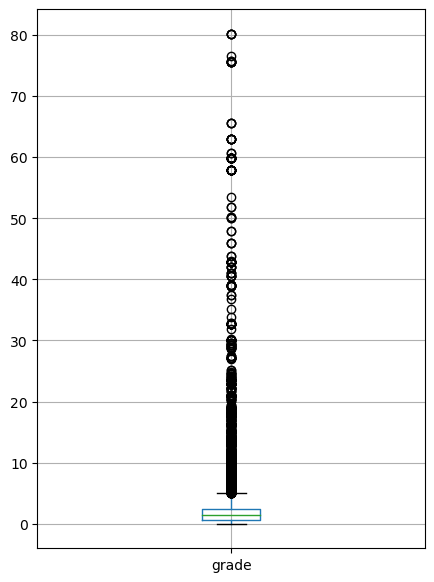

In [530]:
footpath_steepness_gdf.boxplot(['grade'], figsize=(5, 7))

By filtering and observing the results with ```.explore()```, we can find that these skewed results are due to the include of vehicle ramps, paths with stair cases, and features that are not typically considered parth of the footpath (such as the Tianjin Gardens near the Lonsdale entrance to Parliament station).

A manual inspection finds that a threshold of roughly 20 will exclude features that are not intended for pedestrians.

In [ ]:
footpath_steepness_gdf[(footpath_steepness_gdf.grade > 20)].explore(column='grade', tiles='cartodbpositron')

In [536]:
# Filtering, also including very short paths
filtered_steepness = footpath_steepness_gdf[(footpath_steepness_gdf['distance'] >= 1.0) &
                                            (footpath_steepness_gdf.grade < 20)]

In [537]:
filtered_steepness.describe()

,distance,rlmin,rlmax,deltaz,grade
count,24926.000000,24926.000000,24926.000000,24926.000000,24926.000000
mean,64.587241,16.466547,18.059291,1.592744,1.875203
std,75.533747,13.104421,13.380381,2.071823,2.021160
min,1.000000,0.020000,0.110000,0.000000,0.000000
25%,16.800000,2.780000,4.130000,0.380000,0.685460
50%,41.580000,14.630000,16.750000,0.810000,1.346893
75%,88.520000,26.920000,28.690000,1.990000,2.400214
max,831.180000,50.450000,50.670000,27.540000,19.472139


In [552]:
steep_grid=create_grid(100)

In [553]:
steep = filtered_steepness.loc[:, ["geometry", "grade"]].sjoin(steep_grid)

steep_grid = steep_grid.join(
    steep.dissolve(by="index_right", aggfunc="mean").drop(columns="geometry")
)

steep_grid = steep_grid.dropna().round(4)

In [743]:
# Creating the colourmap
steep_cmap = cm.StepColormap(
    colors=['#ffffd9','#edf8b1','#c7e9b4','#7fcdbb','#41b6c4','#1d91c0','#225ea8','#253494','#081d58'],
    vmin = 0,
    vmax = 19.472139,
    index = [0, 0.679365, 1, 1.343569, 1.84, 2.383485, 5,  11, 19.472139],
    caption = 'Footpath grade')

steep_grid.explore(
    column='grade',
    cmap=steep_cmap,
    tiles="CartoDB positron",
    zoom_start=13
)

We can see there is varying steepness throughout the City of Melbourne, particularly in the Hoddle Grid we see a lot of steep streets. Zooming in we can see that the southern end of Elizabeth Street is quite flat, to be expected given that is built on top of a river.

We can see a number of steep streets in East Melbourne, which might impact the walkability for residents there given the age demographics skew older there.

### Roads and walkability

Vehicle volume and speeds on adjacent roads can impact comfort as well as pedestrian safety (which was explored in the Pedestrian Safety use case). A higher volume of traffic might also have impacts on footpath width, which can affect accessibility and ability to move safely and quickly when an area is crowded. It might change the frequency of crossing points which will affect trip time, and can increase the likelihood a pedestrian will try to cross illegally. Trip time is also affected by traffic light cycles which affect the time it takes pedestrians to cross roads, which can have a significant economic impact as small delays are amplified by large volumes of daily use. Road engineers must balance the needs of pedestrians and vehicles when choosing these factors.

This analysis will identify which roads have high traffic volumes, a higher percentage of trucks, and higher speeds, factors which might discourage people from using those roads for walking.

In [555]:
# Getting the road data set
road_url = "https://data.melbourne.vic.gov.au/explore/dataset/road-corridors/download/?format=geojson&timezone=Australia/Sydney&lang=en"
road_response = requests.get(url=road_url)
road_corridor_gdf = to_geopandas(road_response)

Obviously the river is not relevant since Melbourne doesn't have a high volume of traffic on the Yarra, and it is mainly used for leisure. We should also filter out places where pedestrians aren't allowed, such as freeways.

In [556]:
road_corridor_gdf_filtered = road_corridor_gdf[~road_corridor_gdf.str_type.isin(['River', 'Freeway', 'Citylink', 'Port Roads', 'Rail/Tram'])]
road_corridor_gdf_filtered.head()

,geometry,dtupdate,seg_id,street_id,str_type,poly_area,seg_descr,seg_part,status_id,gisid
0,"MULTIPOLYGON (((144.95053 -37.80718, 144.95081...",20210923,21428,0,Arterial,901,Intersection of King Street and Stanley Street,1,1,1136
1,"MULTIPOLYGON (((144.96182 -37.81894, 144.96144...",20210923,20395,1116,Council Minor,481,Tavistock Place between Flinders Street and Fl...,1,3,3329
2,"MULTIPOLYGON (((144.96661 -37.80692, 144.96674...",20210923,20734,1128,Council Minor,424,Trades Hall Place from Victoria Street,1,3,1538
3,"MULTIPOLYGON (((144.96573 -37.79576, 144.96576...",20210923,30258,1555,Private,78,PL5061,1,4,192
4,"MULTIPOLYGON (((144.95031 -37.80731, 144.95053...",20210923,21429,1089,Council Major,6118,Stanley Street between King Street and Spencer...,1,2,1137


Next, the speed and traffic volume datasets will be imported and applied to the road network.

In [557]:
# filter for the City of Melbourne LGA, since the datasets are state wide
gdf_mask = LGA_shape_gdf

speed = gpd.read_file("./interactive_dependencies//walkability/Speed_Zones.shp", mask=gdf_mask)

volumes = gpd.read_file("./interactive_dependencies//walkability/Traffic_Volume.shp", mask=gdf_mask)

We can again filter for freeways in the traffic volumes dataset. The relevant columns in this dataset are the annual number of vehicles, as well as the percentage of that traffic which is trucks.

In [559]:
# Can filter out 'FW' From RMA_CLSFCN because freeway
volumes_filtered = volumes[~volumes.RMA_CLSFCN.isin(['FW'])]

# Converting to the correct coordinate system
volumes_filtered = volumes_filtered.to_crs('EPSG:4326')

# Joining with the road network
road_vol = gpd.sjoin(road_corridor_gdf_filtered, volumes_filtered)

# Column filtering
road_vol_filt = road_vol.filter(['ALLVEHS_AA', 'PER_TRUCKS', 'TRUCKS_AAD', 'LOCAL_ROAD', 'geometry'])

We can also remove a particular road which has a high volume of trucks, which is part of the industrial area.

In [581]:
road_vol_filt = road_vol_filt[~(road_vol_filt.LOCAL_ROAD == 'DOCK LINK ROAD')]

Now we can normalise the metrics for annual vehicle volume and truck percentage, and combine them into a single score.

In [752]:
volume_scaler = MinMaxScaler()
truck_scaler = MinMaxScaler()

road_vol_filt[['vol_norm']] = volume_scaler.fit_transform(road_vol_filt[['ALLVEHS_AA']])
road_vol_filt[['truck_norm']] = truck_scaler.fit_transform(road_vol_filt[['PER_TRUCKS']])

road_vol_filt['volume_score'] = (road_vol_filt['vol_norm'] + road_vol_filt['truck_norm'] )/2

In [754]:
# Final filter
road_vol_filt = road_vol_filt.dropna().drop_duplicates()

Next we will need to prepare the speed zone dataset. We could join this to the dataframe we just created, but the volume dataset is only for major roads. We will join to the road network and merge at the end.

In [757]:
# Convert coordinates
speed = speed.to_crs('EPSG:4326')

# Joining with the road network
road_speed = gpd.sjoin(road_corridor_gdf_filtered, speed)

Visualising the network shows that there are a number of high speed roads which are acutally freeways, as despite our earlier filtering freeways are still being included where they intersect with other roads. Manually we can determine a threshold to filter at by speed.

In [761]:
# for visual inspection
road_speed.explore('SIGN_SPEED')

In [762]:
# Removing freeways
road_speed_filt = road_speed[(road_speed['SIGN_SPEED'] < 80) ]

# Removing duplicates
road_speed_filt=road_speed_filt.drop_duplicates()

# Selecting relevant columns
road_speed_filt = road_speed_filt.filter(['SIGN_SPEED','str_type', 'seg_descr', 'geometry'])

In [766]:
speed_scaler = MinMaxScaler()

road_speed_filt[['speed_norm']] = speed_scaler.fit_transform(road_speed_filt[['SIGN_SPEED']])

Finally we can create a single common metric, and visualise the two individual datasets on one map.

In [768]:
road_metric = road_speed_filt.sjoin(road_vol_filt)
road_metric.head()

,SIGN_SPEED,str_type,seg_descr,geometry,speed_norm,index_right,ALLVEHS_AA,PER_TRUCKS,TRUCKS_AAD,LOCAL_ROAD,vol_norm,truck_norm,volume_score
0,40,Arterial,Intersection of King Street and Stanley Street,"MULTIPOLYGON (((144.95053 -37.80718, 144.95081...",0.500000,942,14000,0.07,858.0,KING STREET,0.300068,0.285714,0.292891
942,40,Arterial,King Street between Rosslyn Street and Stanley...,"MULTIPOLYGON (((144.95074 -37.80739, 144.95101...",0.500000,942,14000,0.07,858.0,KING STREET,0.300068,0.285714,0.292891
2504,40,Arterial,Intersection of King Street and Rosslyn Street,"MULTIPOLYGON (((144.95158 -37.80837, 144.95139...",0.500000,942,14000,0.07,858.0,KING STREET,0.300068,0.285714,0.292891
0,60,Arterial,Intersection of King Street and Stanley Street,"MULTIPOLYGON (((144.95053 -37.80718, 144.95081...",0.833333,942,14000,0.07,858.0,KING STREET,0.300068,0.285714,0.292891
942,60,Arterial,King Street between Rosslyn Street and Stanley...,"MULTIPOLYGON (((144.95074 -37.80739, 144.95101...",0.833333,942,14000,0.07,858.0,KING STREET,0.300068,0.285714,0.292891


In [773]:
road_metric = road_metric.filter(['speed_norm','volume_score', 'seg_descr', 'geometry'])
road_metric['road_score'] = (road_metric['speed_norm'] + road_metric['volume_score']) / 2

In [788]:
road_metric_final = road_metric.drop_duplicates().dropna().round(4)

In [820]:
road_speed_filt.describe()

,SIGN_SPEED,speed_norm
count,13394.000000,13394.000000
mean,46.260266,0.604338
std,9.208896,0.153482
min,10.000000,0.000000
25%,40.000000,0.500000
50%,50.000000,0.666667
75%,50.000000,0.666667
max,70.000000,1.000000


Let's create the final map, layering the information.

In [825]:
road_map = folium.Map(location=[-37.8155, 144.95], tiles='cartodbpositron', min_zoom=11, zoom_start=14)

# LGA border
map_df(
    LGA_shape_gdf,
    road_map,description="City of Melbourne border",
    styleFunction={
    'fillOpacity': 0,
    'color': 'black',
    'opacity': 1,
    'weight': 3},
    show=False
)

s = styleFunction = {'fillOpacity': 0.8,'opacity': 0,'weight':0}

map_df(
    road_speed_filt.round(4), 
    road_map,
    ['speed_norm','SIGN_SPEED','geometry'],
    ['Normalised speed', 'Speed km/h'],
    description='Traffic speed',
    colorMap = cm.StepColormap(
        colors=['#54278f','#756bb1', '#9e9ac8', '#cbc9e2', '#f2f0f7'],
        vmin = 0,
        vmax = 1,
        index = [0, .500000, .666667, .75, 1], 
        caption = 'Path relative cost'),
    styleFunction = s,
    show=False)

map_df(
    road_vol_filt.round(4),
    road_map,
    ['volume_score','vol_norm','ALLVEHS_AA','truck_norm','PER_TRUCKS', 'geometry'],
    ['Combined volume', 'Vehicle volume norm', 'Vehicle volume', 'Truck % norm', 'Truck %'],
    description='Traffic volume',
    colorMap=cm.StepColormap(
        colors=['#feebe2','#fbb4b9', '#f768a1', '#c51b8a', '#7a0177'],
        vmin = 0.094717,
        vmax = 0.853200,
        index = [0.094717, .200319, .239832, .292891, 0.706480], 
        caption = 'Path relative cost'),
    styleFunction = s,
    show=False)


map_df(
    road_metric_final, 
    road_map,
    ['road_score','seg_descr','geometry'],
    ['Combined speed and volume', 'Description'],
    description='Summary',
    styleFunction = s,
    colorMap = cm.StepColormap(
        colors=['#0868ac','#43a2ca', '#7bccc4', '#bae4bc', '#f0f9e8'],
        vmin = 0.083800,
        vmax = 0.853200,
        index = [0.083800, .407700, .454400, .521300, 0.853200], 
        caption = 'Path relative cost'),
    show=True)

In [826]:
folium.LayerControl().add_to(road_map)

road_map

From the combined metric, we can see that the better traffic conditions for walkaiblity can be seen in the Hoddle Grid and around Carlton, and to a lesser degree Southbank. Looking in more detail into the volume and speed metrics, we can see the flow of traffic through the arterial roads, particularly the western arterial roads that connect to the freeways. In some areas of the city, such as the port Melbourne Area, speeds are generally high reflecting the industrial nature of the area. However, the Hoddle Grid mostly consists of signed speeds of 40 or below.

<div class="usecase-section-header">Further areas of interest</div>

This use case could be combined with other analyses in the Melbourne Open Data Playground for further insights. Suggestions :

- Combine the traffic analysis with the pedestrian safety and pedestrian traffic use cases analysis to identify which areas of the city are being frequented by pedestrians where road speeds could be adjusted to improve safety
- Extend the accessibility analysis from steepness by looking at footpath width, or the frequency of rest spots
- Analyse other impacts on walkablity such as thermal comfort and air quality (these are usually difficult to quantify due to a lack of sensors, but can be implicitly expressed through the presence of trees and vegetation) <a href="#fn-11">[11]</a>. High levels of tree canopy is more impactful on mental health than grassy areas<a href="#fn-12">[12]</a>, with trees also contributing better to the mitigation of heat island effects and providing more comfort in summer. It might be expected that greenery is key characteristic of healthy neighbourhoods, however there is evidence that walkability is not always associated with greenery. A study on the suburbs of Sydney found a negative relationship between greenness and walkability, in line with previous research<a href="#fn-1">[1]</a>. They noted that the Sydney CBD and surrounding neighbourhoods providing many opportunities for utilitarian walking, but fewer green spaces such as parks.

#### Further reading

Proposed pedestrian improvement projects already taking place in the City of Melbourne:
https://participate.melbourne.vic.gov.au/east-melbourne-road-safety/

Open source software for calculating spatial indicators for healthy, sustainable cities using open or custom data: https://github.com/global-healthy-liveable-cities (requires Docker)

<div class="usecase-section-header">References</div>

- <fn id="fn-1">[1] Dovey, K & Pafka, E (January 2020). _What is walkability? The urban DMA_. Urban Studies. 57 (1): 93–108. doi:10.1177/0042098018819727. </fn>

- <fn id="fn-2">[2] Lowe, M et al. (June 2022). _City planning policies to support health and sustainability: an international comparison of policy indicators for 25 cities_. The Lancet Global Health 10(6), 882-894.</fn>

- <fn id="fn-3">[3] Gunn LD, Davern M, Higgs C, Both A, Roberts R, Rozek J, Giles-Corti B. (2020). _Measuring liveability for the 21 largest
cities in Australia: Liveability Report for Melbourne_. Melbourne: RMIT University, Centre for Urban Research</fn>

- <fn id="fn-4">[4] Koohsari MJ, Sugiyama T, Lamb KE, Villanueva K, Owen N. (2014). _Street connectivity and walking for transport: Role of neighbourhood destinations_. Preventative Medicine</fn>

- <fn id="fn-5">[5] Giles-Corti B, Macaulay G, Middleton N, Boruff B, Bull F, Butterworth I, Badland H, Mavoa S, Roberts R, Christian H. (2014). Developing a research and practice tool to measure walkability: a demonstration project. Health promotion journal of Australia : official journal of Australian Association of Health Promotion Professionals. 25(3): 160-6</fn>

- <fn id="fn-6">[6] Boulange C, Gunn L, Giles-Corti B, Pettit CJ, Badland H. (2017). Examining associations between urban design attributes and transport mode choices for walking, cycling, public transport and private motor vehicle trips. J Transport and Health</fn>

- <fn id="fn-7">[7] Boeing et al. (2022). _Using open data and open-source software to develop spatial indicators of urban design and transport features for achieving healthy and sustainable cities_, The Lancet Global Health, 10(6), 907-918, https://doi.org/10.1016/S2214-109X(22)00072-9.</fn>

- <fn id="fn-8">[8] Cerin et al. (). _ Determining thresholds for spatial urban design and transport features that support walking to create healthy and sustainable cities: findings from the IPEN Adult study_, The Lancet Global Health, 10(6), 895-906.</fn>

- <fn id="fn-9">[9] Lowe M 2022 Australian cities failing on walkability https://pursuit.unimelb.edu.au/articles/australian-cities-failing-on-walkability First published on 5 July 2022 in Design</fn>

- <fn id="fn-10">[10] Baker K, Burgess S, Travers B (2018) _Transport Strategy refresh 2018_, MRCagney’s Melbourne office</fn>

- <fn id="fn-11">[11] Baobeid A, Koç M, Al-Ghamdi SG (2021). _Walkability and Its Relationships With Health, Sustainability, and Livability: Elements of Physical Environment and Evaluation Frameworks_, Frontiers in Built Environment, 7, 10.3389/fbuil.2021.721218.</fn>

- <fn id="fn-12">[12] Astell-Burt T, Feng X. Association of Urban Green Space With Mental Health
and General Health Among Adults in Australia. _JAMA Network Open_. 2019; 2(7):22. https://doi.org/10.1001/jamanetworkopen.2019.8209</fn>